## Import Libraries

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.figure_factory as ff
import seaborn as sns

dataset = pd.read_csv("Dataset 3.csv")
dataset

,YEAR,MO,DY,HR,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M
0,2010,1,1,0:00:00,24.37,21.81,23.09,16.30,85.56,0.0,100.66,1.79,240.97
1,2010,1,1,1:00:00,24.14,21.77,22.95,16.30,86.56,0.0,100.62,1.65,243.92
2,2010,1,1,2:00:00,23.99,21.75,22.87,16.24,87.19,0.0,100.58,1.47,250.12
3,2010,1,1,3:00:00,23.87,21.80,22.83,16.30,88.12,0.0,100.58,1.31,255.88
4,2010,1,1,4:00:00,23.74,21.85,22.80,16.36,89.12,0.0,100.60,1.19,263.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...
70123,2017,12,31,19:00:00,25.40,20.30,22.85,14.83,73.25,0.0,100.65,1.75,298.86
70124,2017,12,31,20:00:00,25.11,19.84,22.48,14.40,72.56,0.0,100.73,1.73,295.75
70125,2017,12,31,21:00:00,24.87,19.41,22.14,14.04,71.62,0.0,100.78,1.66,296.93
70126,2017,12,31,22:00:00,24.74,18.89,21.82,13.55,69.88,0.0,100.78,1.48,303.61


In [ ]:
# convert the year, month, and day to date format
dataset.loc[:,'Date'] = pd.to_datetime(dataset.YEAR.astype(str) + ' ' + dataset.MO.astype(str) + ' ' + dataset.DY.astype(str) + ' ' + dataset.HR.astype(str))

In [ ]:
# remove the year, month and date columns
dataset = dataset.iloc[:, 4:]
# set the date as index
dataset.set_index('Date', inplace=True)
dataset

,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M
Date,,,,,,,,,
2010-01-01 00:00:00,24.37,21.81,23.09,16.30,85.56,0.0,100.66,1.79,240.97
2010-01-01 01:00:00,24.14,21.77,22.95,16.30,86.56,0.0,100.62,1.65,243.92
2010-01-01 02:00:00,23.99,21.75,22.87,16.24,87.19,0.0,100.58,1.47,250.12
2010-01-01 03:00:00,23.87,21.80,22.83,16.30,88.12,0.0,100.58,1.31,255.88
2010-01-01 04:00:00,23.74,21.85,22.80,16.36,89.12,0.0,100.60,1.19,263.58
...,...,...,...,...,...,...,...,...,...
2017-12-31 19:00:00,25.40,20.30,22.85,14.83,73.25,0.0,100.65,1.75,298.86
2017-12-31 20:00:00,25.11,19.84,22.48,14.40,72.56,0.0,100.73,1.73,295.75
2017-12-31 21:00:00,24.87,19.41,22.14,14.04,71.62,0.0,100.78,1.66,296.93


In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 70128 entries, 2010-01-01 00:00:00 to 2017-12-31 23:00:00
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   T2M          70128 non-null  float64
 1   T2MDEW       70128 non-null  float64
 2   T2MWET       70128 non-null  float64
 3   QV2M         70128 non-null  float64
 4   RH2M         70128 non-null  float64
 5   PRECTOTCORR  70128 non-null  float64
 6   PS           70128 non-null  float64
 7   WS10M        70128 non-null  float64
 8   WD10M        70128 non-null  float64
dtypes: float64(9)
memory usage: 5.4 MB


In [ ]:
dataset.describe()

,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M
count,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000
mean,25.904549,23.521527,24.713027,18.183131,87.477036,0.337354,100.651882,2.398212,226.626938
std,2.261126,1.695625,1.594662,1.693558,11.172587,0.607365,0.201380,0.895252,52.344774
min,14.730000,9.400000,12.080000,7.320000,33.060000,0.000000,99.970000,0.020000,0.000000
25%,24.270000,23.150000,23.830000,17.700000,80.560000,0.030000,100.510000,1.870000,209.460000
50%,25.520000,23.870000,24.800000,18.490000,92.190000,0.150000,100.650000,2.280000,224.150000
75%,27.430000,24.470000,25.780000,19.170000,96.440000,0.410000,100.790000,2.840000,245.110000
max,33.730000,27.130000,29.130000,22.580000,100.000000,20.780000,101.350000,7.460000,359.880000


In [ ]:
# Function to plot interactive plots using Plotly Express
def interactive_plot(df, column, timestamp, title):
  '''
  df: dataframe, the dataset.
  column: str, name of column you want to plot
  title: str, title of the plot
  timestamp: str, column of the time for the time series data
  '''
  fig = px.line(title=title)
  for i in df[[column]]:
    fig.add_scatter(x=timestamp, y=df[i], name=i)
  fig.show()
              
interactive_plot(dataset, 'PS', dataset.index, 'Surface Pressure Data')       

In [ ]:
dataset['Next PS'] = dataset[['PS']].shift(-1)
dataset

,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M,Next PS
Date,,,,,,,,,,
2010-01-01 00:00:00,24.37,21.81,23.09,16.30,85.56,0.0,100.66,1.79,240.97,100.62
2010-01-01 01:00:00,24.14,21.77,22.95,16.30,86.56,0.0,100.62,1.65,243.92,100.58
2010-01-01 02:00:00,23.99,21.75,22.87,16.24,87.19,0.0,100.58,1.47,250.12,100.58
2010-01-01 03:00:00,23.87,21.80,22.83,16.30,88.12,0.0,100.58,1.31,255.88,100.60
2010-01-01 04:00:00,23.74,21.85,22.80,16.36,89.12,0.0,100.60,1.19,263.58,100.62
...,...,...,...,...,...,...,...,...,...,...
2017-12-31 19:00:00,25.40,20.30,22.85,14.83,73.25,0.0,100.65,1.75,298.86,100.73
2017-12-31 20:00:00,25.11,19.84,22.48,14.40,72.56,0.0,100.73,1.73,295.75,100.78
2017-12-31 21:00:00,24.87,19.41,22.14,14.04,71.62,0.0,100.78,1.66,296.93,100.78


In [ ]:
# Remove last nan row
dataset = dataset[:-1]
dataset

,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M,Next PS
Date,,,,,,,,,,
2010-01-01 00:00:00,24.37,21.81,23.09,16.30,85.56,0.0,100.66,1.79,240.97,100.62
2010-01-01 01:00:00,24.14,21.77,22.95,16.30,86.56,0.0,100.62,1.65,243.92,100.58
2010-01-01 02:00:00,23.99,21.75,22.87,16.24,87.19,0.0,100.58,1.47,250.12,100.58
2010-01-01 03:00:00,23.87,21.80,22.83,16.30,88.12,0.0,100.58,1.31,255.88,100.60
2010-01-01 04:00:00,23.74,21.85,22.80,16.36,89.12,0.0,100.60,1.19,263.58,100.62
...,...,...,...,...,...,...,...,...,...,...
2017-12-31 18:00:00,26.12,20.96,23.54,15.50,73.25,0.0,100.58,1.58,306.36,100.65
2017-12-31 19:00:00,25.40,20.30,22.85,14.83,73.25,0.0,100.65,1.75,298.86,100.73
2017-12-31 20:00:00,25.11,19.84,22.48,14.40,72.56,0.0,100.73,1.73,295.75,100.78


## Exploratory Data Analysis



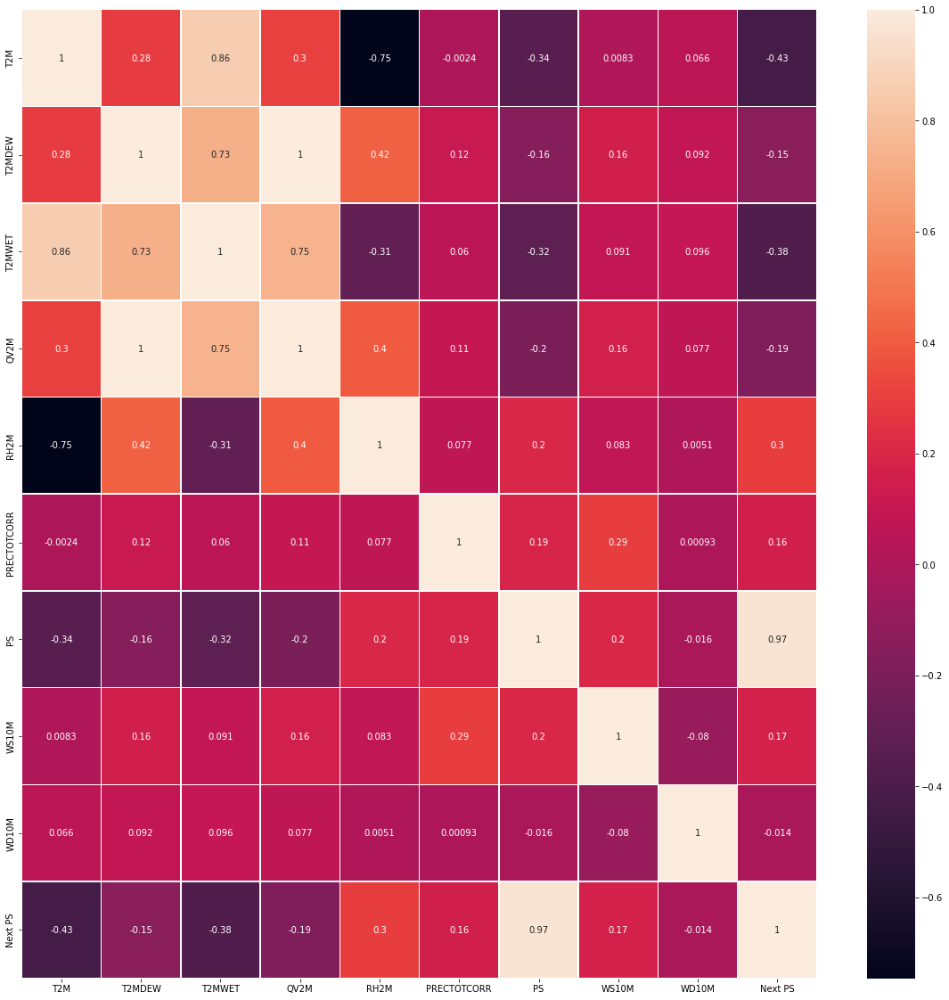

In [ ]:
# Pearson's Corrrelation Plot with Seaborn
fig, ax = plt.subplots(figsize=(20,20))  # Sample figsize in inches
sns.heatmap(dataset.corr(method='pearson'), annot=True, linewidths=.5, ax=ax)

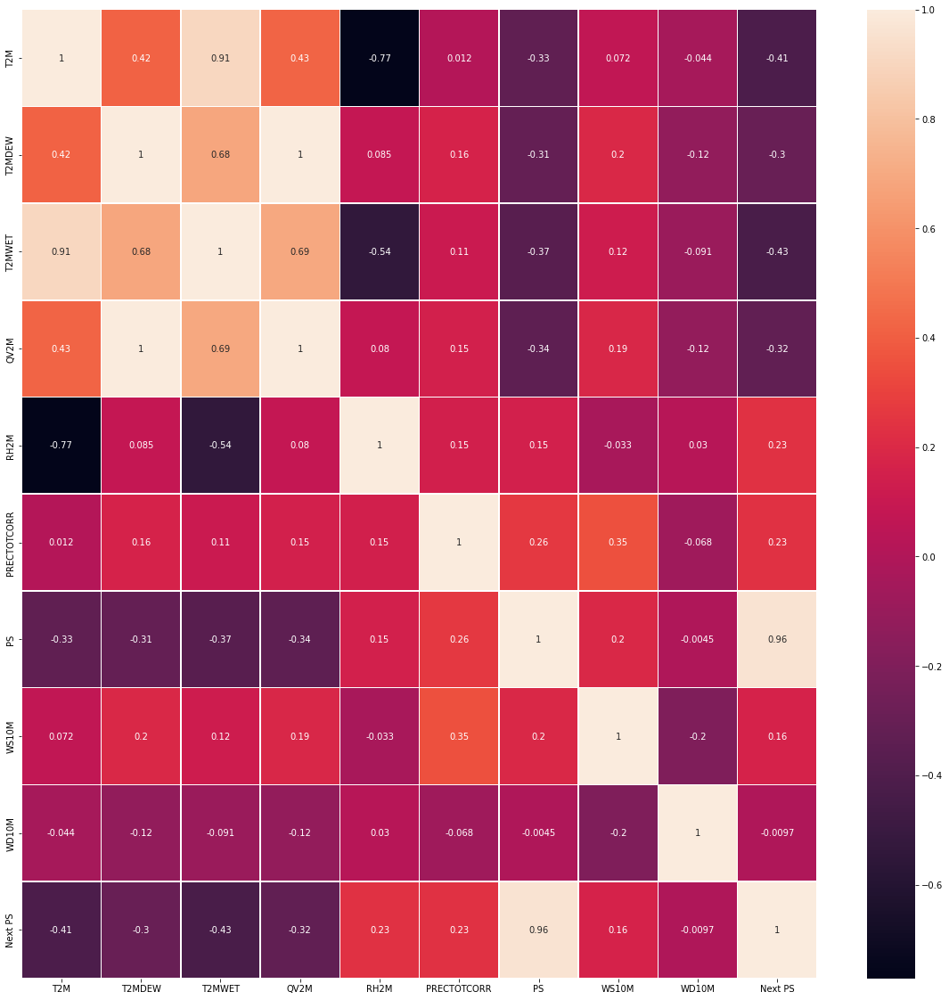

In [ ]:
# Pearson's Corrrelation Plot with Seaborn
fig, ax = plt.subplots(figsize=(20,20))  # Sample figsize in inches
sns.heatmap(dataset.corr(method='spearman'), annot=True, linewidths=.5, ax=ax)

There is a high positive correlation between the PS and Next PS.

#### Visualization to see which features correlate with the future Relative Humidity

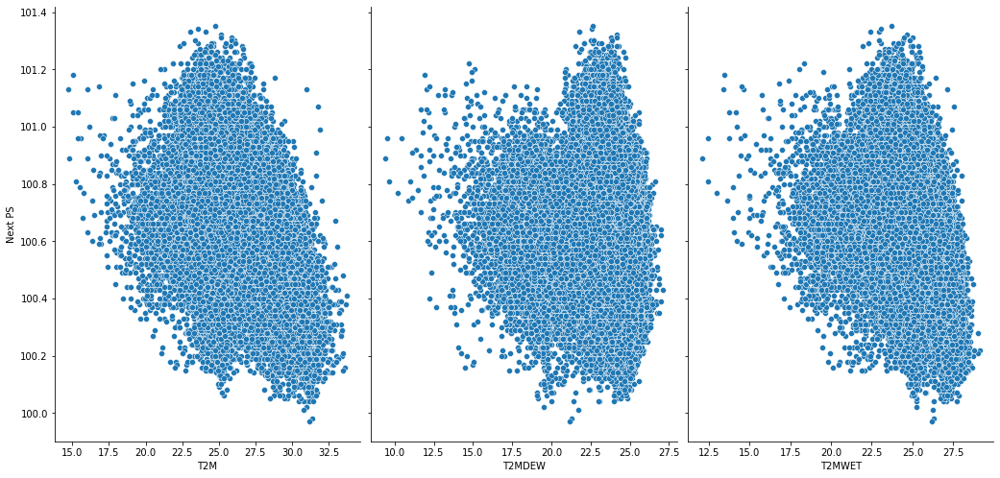

In [ ]:
sns.pairplot(dataset, x_vars=["T2M", "T2MDEW", "T2MWET"],
             y_vars=["Next PS"], height=7, aspect=0.7)

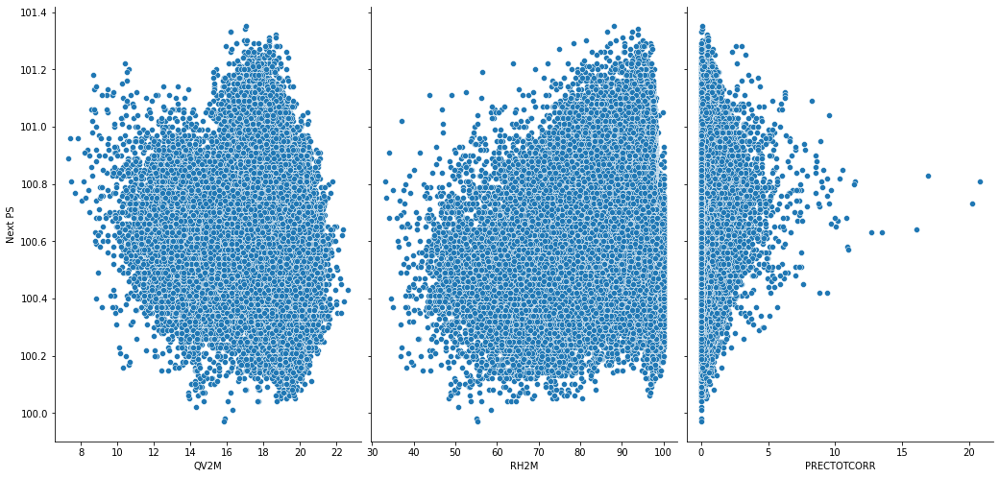

In [ ]:
sns.pairplot(dataset, x_vars=["QV2M", "RH2M", "PRECTOTCORR"],
             y_vars=["Next PS"], height=7, aspect=0.7)

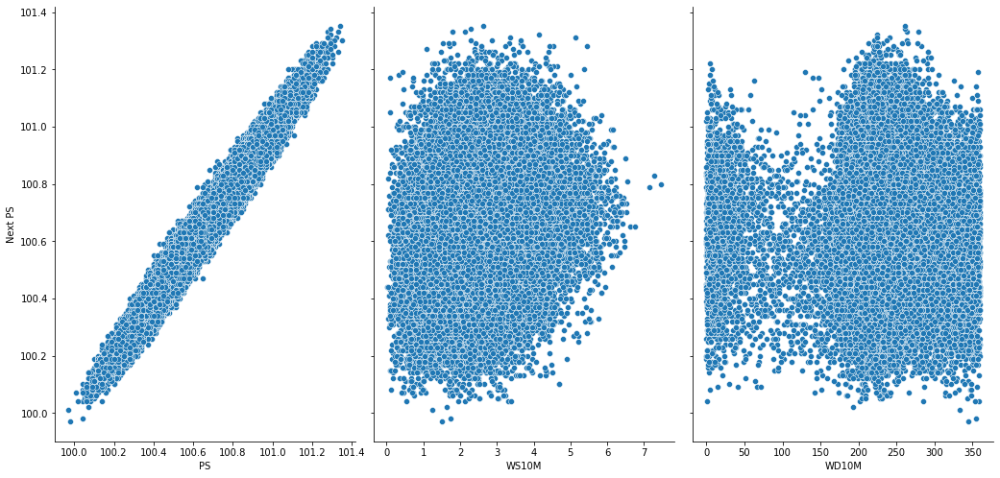

In [ ]:
sns.pairplot(dataset, x_vars=["PS", "WS10M", "WD10M"],
             y_vars=["Next PS"], height=7, aspect=0.7)

## Create Model to Predict Future Surface Pressure

In [ ]:
ps_data = dataset[["PS", "T2M", "T2MWET", "Next PS"]]
ps_data

,PS,T2M,T2MWET,Next PS
Date,,,,
2010-01-01 00:00:00,100.66,24.37,23.09,100.62
2010-01-01 01:00:00,100.62,24.14,22.95,100.58
2010-01-01 02:00:00,100.58,23.99,22.87,100.58
2010-01-01 03:00:00,100.58,23.87,22.83,100.60
2010-01-01 04:00:00,100.60,23.74,22.80,100.62
...,...,...,...,...
2017-12-31 18:00:00,100.58,26.12,23.54,100.65
2017-12-31 19:00:00,100.65,25.40,22.85,100.73
2017-12-31 20:00:00,100.73,25.11,22.48,100.78


### Standardize the Data

In [ ]:
# Feature Scaling
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaled_ps_data = scaler.fit_transform(ps_data)

print("Mean of each column", scaler.mean_)
print("Variance of each column", scaler.var_)
scaled_ps_data

Mean of each column [100.65188045  25.90456771  24.71307285 100.65188173]
Variance of each column [0.04055365 5.11266582 2.54280064 0.04055379]


array([[ 0.04031969, -0.67867578, -1.01784549, -0.15831649],
       [-0.15831039, -0.78039526, -1.10564092, -0.35694624],
       [-0.35694047, -0.84673406, -1.15580973, -0.35694624],
       ...,
       [ 0.38792234, -0.35140441, -1.4003827 ,  0.6362025 ],
       [ 0.63620994, -0.45754648, -1.61360016,  0.6362025 ],
       [ 0.63620994, -0.5150401 , -1.81427541,  0.48723019]])

#### Remember, you can't use shuffle the data when splitting it to the train and test set because it is a time series data.

In [ ]:
# Create Matrix of Features and target variable without scaling**
X = scaled_ps_data[:, :-1]
y = scaled_ps_data[:, -1]
print("Matrix of features", X, sep='\n')
print("--------------------------------------------------")
print("Target Variable", y, sep='\n')
print("--------------------------------------------------")
print("Shape of the Matrix of features", X.shape, sep='\n')
print("Shape of the target variable", y.shape, sep='\n')

Matrix of features
[[ 0.04031969 -0.67867578 -1.01784549]
 [-0.15831039 -0.78039526 -1.10564092]
 [-0.35694047 -0.84673406 -1.15580973]
 ...
 [ 0.38792234 -0.35140441 -1.4003827 ]
 [ 0.63620994 -0.45754648 -1.61360016]
 [ 0.63620994 -0.5150401  -1.81427541]]
--------------------------------------------------
Target Variable
[-0.15831649 -0.35694624 -0.35694624 ...  0.6362025   0.6362025
  0.48723019]
--------------------------------------------------
Shape of the Matrix of features
(70127, 3)
Shape of the target variable
(70127,)


In [ ]:
# Splitting Dataset into Training and Validation Set
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25,
                                                  shuffle=False)

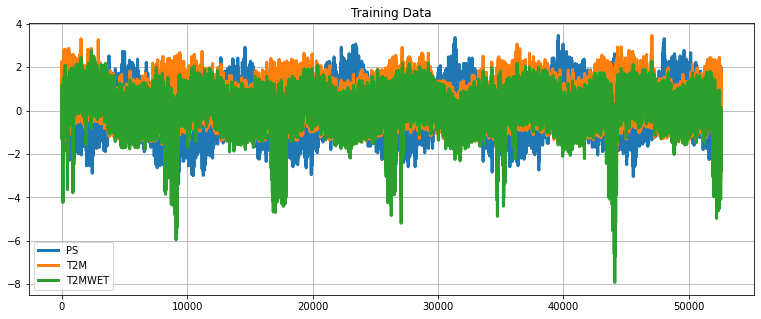

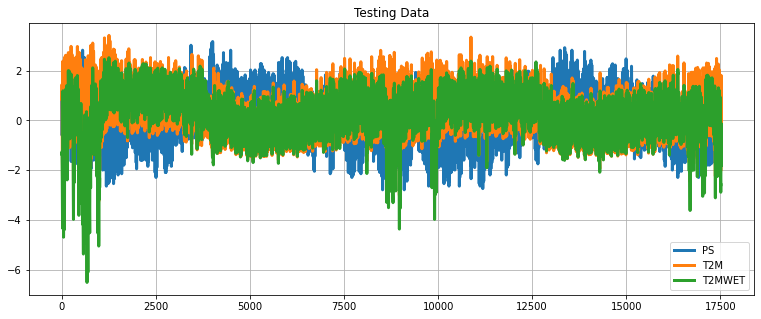

In [ ]:
# Define a data plotting function
def show_plot(data, title):
  plt.figure(figsize=(13, 5))
  plt.plot(data, linewidth=3)
  plt.title(title)
  plt.legend(["PS", "T2M", "T2MWET"])
  plt.grid()

show_plot(X_train, "Training Data")
show_plot(X_val, "Testing Data")

## Ridge Regression

In [ ]:
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import Ridge

# fit model to training data
ridge_model = Ridge(alpha=0.5)
ridge_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_1 = ridge_model.predict(X_val)
print("R Squared on Validation Set: ", ridge_model.score(X_val, y_val))
print("RMSE of Ridge Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_1)))

R Squared on Validation Set:  0.9460065488735653
RMSE of Ridge Regressor:  0.23086955165291462


In [ ]:
from math import sqrt

# Make Predictions on the entire dataset
y_pred = ridge_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_ps_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Function to plot interactive plots using Plotly Express
def interactive_plot2(df, title):
  fig = px.line(title=title)
  for i in df.columns:
    fig.add_scatter(x=df.index, y=df[i], name=i)
  fig.show()

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (Ridge)")

Model Prediction on entire dataset [ 0.0809672  -0.09180166 -0.26815538 ...  0.32045915  0.55491605
  0.55115776]
Original y [100.62 100.58 100.58 ... 100.78 100.78 100.75]
Unstandardized y_pred [100.66818688 100.63339474 100.59788068 ... 100.7164157  100.76363056
 100.76287371]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00  100.62  100.668187
2010-01-01 01:00:00  100.58  100.633395
2010-01-01 02:00:00  100.58  100.597881
2010-01-01 03:00:00  100.60  100.599397
2010-01-01 04:00:00  100.62  100.619731
2010-01-01 05:00:00  100.66  100.640873
2010-01-01 06:00:00  100.71  100.680727
2010-01-01 07:00:00  100.78  100.719669
2010-01-01 08:00:00  100.80  100.767424
2010-01-01 09:00:00  100.78  100.768525
2010-01-01 10:00:00  100.71  100.732405
2010-01-01 11:00:00  100.62  100.654347
2010-01-01 12:00:00  100.53  100.562657
2010-01-01 13:00:00  100.45  100.474448
2010-01-01 14:00:00  100.42  100.398213


## Lasso Regression

In [ ]:
from sklearn.linear_model import Lasso

# fit model to training data
lasso_model = Lasso(alpha=0.0005)
lasso_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_2 = lasso_model.predict(X_val)
print("R Squared Lasso Regressor: ", lasso_model.score(X_val, y_val))
print("RMSE of Lasso Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_2)))

R Squared Lasso Regressor:  0.9460305221912324
RMSE of Lasso Regressor:  0.2308182924401686


In [ ]:
# Make Predictions on the entire dataset
y_pred = lasso_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_ps_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (Lasso)")

Model Prediction on entire dataset [ 0.08233713 -0.09037765 -0.26669135 ...  0.32439654  0.55917178
  0.55598278]
Original y [100.62 100.58 100.58 ... 100.78 100.78 100.75]
Unstandardized y_pred [100.66846276 100.63368151 100.5981755  ... 100.71720861 100.76448758
 100.76384538]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00  100.62  100.668463
2010-01-01 01:00:00  100.58  100.633682
2010-01-01 02:00:00  100.58  100.598176
2010-01-01 03:00:00  100.60  100.599672
2010-01-01 04:00:00  100.62  100.619967
2010-01-01 05:00:00  100.66  100.641069
2010-01-01 06:00:00  100.71  100.680876
2010-01-01 07:00:00  100.78  100.719655
2010-01-01 08:00:00  100.80  100.767416
2010-01-01 09:00:00  100.78  100.768624
2010-01-01 10:00:00  100.71  100.732760
2010-01-01 11:00:00  100.62  100.654912
2010-01-01 12:00:00  100.53  100.563397
2010-01-01 13:00:00  100.45  100.475318
2010-01-01 14:00:00  100.42  100.399187


## Decision Tree Regression

In [ ]:
from sklearn.tree import DecisionTreeRegressor

# fit model to training data
dt_model = DecisionTreeRegressor(max_leaf_nodes=50,
                                 random_state=1)
dt_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_4 = dt_model.predict(X_val)
print("R Squared Decision Tree Regressor: ", dt_model.score(X_val, y_val))
print("RMSE of Decision Tree Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_4)))

R Squared Decision Tree Regressor:  0.945152490269803
RMSE of Decision Tree Regressor:  0.23268831397746922


In [ ]:
# Make Predictions on the entire dataset
y_pred = dt_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_ps_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (Decision Tree)")

Model Prediction on entire dataset [ 0.13366369 -0.09978491 -0.29734306 ...  0.48142698  0.62649006
  0.62649006]
Original y [100.62 100.58 100.58 ... 100.78 100.78 100.75]
Unstandardized y_pred [100.67879888 100.63178707 100.59200287 ... 100.74883135 100.77804411
 100.77804411]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00  100.62  100.678799
2010-01-01 01:00:00  100.58  100.631787
2010-01-01 02:00:00  100.58  100.592003
2010-01-01 03:00:00  100.60  100.592003
2010-01-01 04:00:00  100.62  100.615036
2010-01-01 05:00:00  100.66  100.631787
2010-01-01 06:00:00  100.71  100.678799
2010-01-01 07:00:00  100.78  100.726019
2010-01-01 08:00:00  100.80  100.778044
2010-01-01 09:00:00  100.78  100.759479
2010-01-01 10:00:00  100.71  100.703630
2010-01-01 11:00:00  100.62  100.649544
2010-01-01 12:00:00  100.53  100.588221
2010-01-01 13:00:00  100.45  100.493908
2010-01-01 14:00:00  100.42  100.398065


## XGBoost Regressor

In [ ]:
from xgboost import XGBRegressor

# check for the best number of n_estimators
xgboost_model = XGBRegressor(n_estimators=1000, learning_rate=0.1, n_jobs=-1)
xgboost_model.fit(X_train, y_train,
                  early_stopping_rounds=20,
                  eval_set=[(X_val, y_val)],
                  verbose=True)


[12:27:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:0.992599
Will train until validation_0-rmse hasn't improved in 20 rounds.
[1]	validation_0-rmse:0.902706
[2]	validation_0-rmse:0.821839
[3]	validation_0-rmse:0.749822
[4]	validation_0-rmse:0.685867
[5]	validation_0-rmse:0.628324
[6]	validation_0-rmse:0.57753
[7]	validation_0-rmse:0.531918
[8]	validation_0-rmse:0.491344
[9]	validation_0-rmse:0.455636
[10]	validation_0-rmse:0.424053
[11]	validation_0-rmse:0.396551
[12]	validation_0-rmse:0.372745
[13]	validation_0-rmse:0.351763
[14]	validation_0-rmse:0.332596
[15]	validation_0-rmse:0.316323
[16]	validation_0-rmse:0.302102
[17]	validation_0-rmse:0.28942
[18]	validation_0-rmse:0.279362
[19]	validation_0-rmse:0.27052
[20]	validation_0-rmse:0.262501
[21]	validation_0-rmse:0.256158
[22]	validation_0-rmse:0.250636
[23]	validation_0-rmse:0.246202
[24]	validation_0-rmse:0.242434
[25]	validation_0-rms

XGBRegressor(n_estimators=1000, n_jobs=-1)

In [ ]:
# fit model to training data
from xgboost import XGBRegressor
xgboost_model = XGBRegressor(n_estimators=346, learning_rate=0.1)
xgboost_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_5 = xgboost_model.predict(X_val)
print("R Squared XGBoost Regressor: ", xgboost_model.score(X_val, y_val))
print("RMSE of XGBoost Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_5)))

[12:28:09] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
R Squared XGBoost Regressor:  0.9520706162318984
RMSE of XGBoost Regressor:  0.21751892010928156


In [ ]:
# Make Predictions on the entire dataset
y_pred = xgboost_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_ps_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (XGBoost)")

Model Prediction on entire dataset [ 0.0844585  -0.09048396 -0.26972497 ...  0.43541944  0.61349005
  0.60964143]
Original y [100.62 100.58 100.58 ... 100.78 100.78 100.75]
Unstandardized y_pred [100.668884 100.63366  100.597565 ... 100.73956  100.77542  100.77465 ]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00  100.62  100.668884
2010-01-01 01:00:00  100.58  100.633659
2010-01-01 02:00:00  100.58  100.597565
2010-01-01 03:00:00  100.60  100.601685
2010-01-01 04:00:00  100.62  100.615883
2010-01-01 05:00:00  100.66  100.638611
2010-01-01 06:00:00  100.71  100.676308
2010-01-01 07:00:00  100.78  100.724350
2010-01-01 08:00:00  100.80  100.776176
2010-01-01 09:00:00  100.78  100.737274
2010-01-01 10:00:00  100.71  100.700424
2010-01-01 11:00:00  100.62  100.638657
2010-01-01 12:00:00  100.53  100.558983
2010-01-01 13:00:00  100.45  100.467003
2010-01-01 14:00:00  100.42  100.408127
